In [1]:
from models.pt_models import SpeechTherapist
from training.pt_training import SpeechTherapist_trainer, SpeechTherapist_tester
from utils.utils import (
    plot_logopeda,
    calculate_distances_manner,
    plot_logopeda_alb_neuro,
)
from data_loaders.pt_data_loader_spectrograms_manner import Dataset_AudioFeatures
import torch
import wandb
import numpy as np
import pandas as pd
import sys
import os

device = torch.device("cuda:1" if torch.cuda.is_available() else "cpu")
print("Device being used:", device)

Device being used: cuda:1


In [2]:
hyperparams = {
    "frame_size_ms": 0.400,  # 400ms
    "n_plps": 0,
    "n_mfccs": 0,
    "spectrogram_win_size": 0.023,  # 23ms as it is recommended in the librosa library for speech recognition
    "material": "MANNER",
    "hop_size_percent": 0.5,
    "spectrogram": True,
    "wandb_flag": False,
    "epochs": 1000,
    "batch_size": 128,
    "lr": 1e-3,
    "latent_dim": 3,
    "hidden_dims_enc": [64, 1024, 64],
    "hidden_dims_gmvae": [256],
    "weights": [
        1,  # w1 is rec loss,
        1,  # w2 is gaussian kl loss,
        1,  # w3 is categorical kl loss,
        10,  # w5 is metric loss
    ],
    "supervised": False,
    "cnn_classifier": True,
    "n_gaussians": 16,  # 2 per manner class
    "semisupervised": False,
    "train": False,
    "train_albayzin": True,  # If True, only albayzin+neuro is used to train. If False only neuro are used for training
}

In [3]:
print("Reading train, val and test loaders from local_results/...")
train_loader = torch.load(
    "local_results/train_loader_supervised_False_frame_size_0.4spec_winsize_0.023hopsize_0.5.pt"
)
val_loader = torch.load(
    "local_results/val_loader_supervised_False_frame_size_0.4spec_winsize_0.023hopsize_0.5.pt"
)
test_loader = torch.load(
    "local_results/test_loader_supervised_False_frame_size_0.4spec_winsize_0.023hopsize_0.5.pt"
)
test_data = torch.load(
    "local_results/test_data_supervised_False_frame_size_0.4spec_winsize_0.023hopsize_0.5.pt"
)


Reading train, val and test loaders from local_results/...


In [22]:
# Check that in train there is no label==1
for i, (x, y, a, z) in enumerate(train_loader):
    if (y == 1).any():
        print("Error in train_loader")
        break
    if i == len(train_loader) - 1:
        print("No errors in train_loader")

No errors in train_loader


In [21]:
(y==1).any()

tensor(False)

In [4]:
model = SpeechTherapist(
    x_dim=train_loader.dataset[0][0].shape,
    z_dim=hyperparams["latent_dim"],
    n_gaussians=hyperparams["n_gaussians"],
    hidden_dims_spectrogram=hyperparams["hidden_dims_enc"],
    hidden_dims_gmvae=hyperparams["hidden_dims_gmvae"],
    weights=hyperparams["weights"],
    device=device,
    reducer="sum",
)

In [5]:
name = "local_results/spectrograms/manner_gmvae_alb_neurovoz_3unsupervised3d_final_model2/GMVAE_cnn_best_model_2d.pt"
tmp = torch.load(name)
model.load_state_dict(tmp["model_state_dict"])

<All keys matched successfully>

In [6]:
audio_features = "spectrogram"
df_train = pd.DataFrame(columns=[audio_features, "label", "manner"])
df_train[audio_features] = [t[0] for t in train_loader.dataset]
df_train["label"] = [t[1] for t in train_loader.dataset]
df_train["manner"] = [t[2] for t in train_loader.dataset]

# Select randomly 1000 samples of dftrain
# df_train = df_train.sample(n=1000)

# Create an empty pd dataframe with three columns: data, label and manner
df_test = pd.DataFrame(columns=[audio_features, "label", "manner"])
df_test[audio_features] = [t[0] for t in test_loader.dataset]
df_test["label"] = [t[1] for t in test_loader.dataset]
df_test["manner"] = [t[2] for t in test_loader.dataset]

In [7]:
data_test = df_test

model.eval()
with torch.no_grad():
    batch_size = 128
    print("Calculating latent space for test samples")
    data_input = torch.Tensor(np.vstack(data_test["spectrogram"]))
    latent_mu_test_original_space = []
    # do model_infere by batches
    for i in range(0, len(data_input), batch_size):
        e_s = model.spec_encoder_forward(
            data_input[i : i + batch_size].to(model.device).unsqueeze(1)
        )
        (
            _,
            _,
            _,
            latent_mu_test_original_space_batch,
            _,
            _,
            _,
        ) = model.inference_forward(e_s)
        latent_mu_test_original_space.append(
            latent_mu_test_original_space_batch.cpu().detach().numpy()
        )
        del _, latent_mu_test_original_space_batch
    latent_mu_test_original_space = np.vstack(latent_mu_test_original_space)
    torch.cuda.empty_cache()
    del data_input
    print("Latent space calculated")

Calculating latent space for test samples
Latent space calculated


In [10]:
import copy

manner_test = np.array([np.array(x) for x in data_test["manner"]], dtype=int)

labels_test = np.array(data_test["label"].values, dtype=int)

# Repeat labels manner.shape[1] times
latent_mu_test = copy.copy(latent_mu_test_original_space)
lm_test_original = latent_mu_test_original_space
labels_test = np.repeat(labels_test, manner_test.shape[1], axis=0)
manner_test = manner_test.reshape(-1)
manner_test[manner_test > 7] = manner_test[manner_test > 7] - 8
# Remove all affricates
idx = np.argwhere(manner_test == 6).ravel()
manner_test = np.delete(manner_test, idx)
labels_test = np.delete(labels_test, idx)
latent_mu_test = np.delete(latent_mu_test, idx, axis=0)
lm_test_original = np.delete(lm_test_original, idx, axis=0)
# Remove all silence
idx = np.argwhere(manner_test == 7).ravel()
manner_test = np.delete(manner_test, idx)
labels_test = np.delete(labels_test, idx)
latent_mu_test = np.delete(latent_mu_test, idx, axis=0)
lm_test_original = np.delete(lm_test_original, idx, axis=0)

# 3d interative plot in plotly 

In [10]:
latent_mu_test.shape

(294575, 3)

In [12]:
manner_test

array([4, 4, 4, ..., 1, 1, 1])

In [16]:
idx = np.argwhere(manner_test == 5).ravel()
manner_test2 = np.delete(manner_test, idx)
labels_test2 = np.delete(labels_test, idx)
latent_mu_test2 = np.delete(latent_mu_test, idx, axis=0)

# Plot only healthy patients (labels_test2 == 0), so delete labels==1
idx = np.argwhere(labels_test2 == 1).ravel()
manner_test2 = np.delete(manner_test2, idx)
labels_test2 = np.delete(labels_test2, idx)
latent_mu_test2 = np.delete(latent_mu_test2, idx, axis=0)

import plotly.graph_objs as go
import plotly.offline as pyo

pyo.init_notebook_mode()

# Assuming manner_test2 is a list of integers representing categories (0 to 4)
category_names = [
    "Plosive",
    "Plosive voiced",
    "Nasals",
    "Fricatives",
    "Liquids",
    "Vowels",
]

# Create traces for each category
traces = []
for category in set(manner_test2):
    mask = manner_test2 == category
    trace = go.Scatter3d(
        x=latent_mu_test2[mask, 0],
        y=latent_mu_test2[mask, 1],
        z=latent_mu_test2[mask, 2],
        text=[category_names[category]] * sum(mask),  # Use category names
        mode="markers",
        marker=dict(size=8),
        name=category_names[category],
        legendgroup="categories",
    )
    traces.append(trace)

layout = go.Layout(
    title="Latent space of the test set",
    scene=dict(
        xaxis=dict(title="x"),
        yaxis=dict(title="y"),
        zaxis=dict(title="z"),
        camera=dict(
            eye=dict(x=-1.75, y=-1.75, z=0.5),  # Set the eye coordinates manually
            center=dict(x=0, y=0, z=0),  # Set the center coordinates manually
            up=dict(x=0, y=0, z=2.5),  # Set the up vector manually
        ),
    ),
    margin=dict(r=0, b=0, l=0, t=0),
    legend=dict(x=0, y=1.0),  # Adjust the legend position as needed
)

fig = go.Figure(data=traces, layout=layout)
pyo.iplot(fig, filename="3d-scatter-categories")

In [ ]:

# Plot only healthy patients (labels_test2 == 0), so delete labels==1
idx = np.argwhere(labels_test == 1).ravel()
manner_test2 = np.delete(manner_test, idx)
labels_test2 = np.delete(labels_test, idx)
latent_mu_test2 = np.delete(latent_mu_test, idx, axis=0)

import plotly.graph_objs as go
import plotly.offline as pyo

pyo.init_notebook_mode()

# Assuming manner_test2 is a list of integers representing categories (0 to 4)
category_names = [
    "Plosive",
    "Plosive voiced",
    "Nasals",
    "Fricatives",
    "Liquids",
    "Vowels",
]

# Create traces for each category
traces = []
for category in set(manner_test2):
    mask = manner_test2 == category
    trace = go.Scatter3d(
        x=latent_mu_test2[mask, 0],
        y=latent_mu_test2[mask, 1],
        z=latent_mu_test2[mask, 2],
        text=[category_names[category]] * sum(mask),  # Use category names
        mode="markers",
        marker=dict(size=8),
        name=category_names[category],
        legendgroup="categories",
    )
    traces.append(trace)

layout = go.Layout(
    title="Latent space of the test set",
    scene=dict(
        xaxis=dict(title="x"),
        yaxis=dict(title="y"),
        zaxis=dict(title="z"),
        camera=dict(
            eye=dict(x=-1.75, y=-1.75, z=0.5),  # Set the eye coordinates manually
            center=dict(x=0, y=0, z=0),  # Set the center coordinates manually
            up=dict(x=0, y=0, z=2.5),  # Set the up vector manually
        ),
    ),
    margin=dict(r=0, b=0, l=0, t=0),
    legend=dict(x=0, y=1.0),  # Adjust the legend position as needed
)

fig = go.Figure(data=traces, layout=layout)
pyo.iplot(fig, filename="3d-scatter-categories")

In [48]:
# Do not plot vowels which are manner_test == 5
idx = np.argwhere(manner_test == 5).ravel()
manner_test2 = np.delete(manner_test, idx)
labels_test2 = np.delete(labels_test, idx)
latent_mu_test2 = np.delete(latent_mu_test, idx, axis=0)

# Plot only healthy patients (labels_test2 == 0)
idx = np.argwhere(labels_test2 == 0).ravel()
manner_test2 = np.delete(manner_test2, idx)
labels_test2 = np.delete(labels_test2, idx)
latent_mu_test2 = np.delete(latent_mu_test2, idx, axis=0)

import plotly.graph_objs as go
import plotly.offline as pyo

pyo.init_notebook_mode()

# Assuming manner_test2 is a list of integers representing categories (0 to 4)
category_names = ["Plosive", "Plosive voiced", "Nasals", "Fricatives", "Liquids"]

# Create traces for each category
traces = []
for category in set(manner_test2):
    mask = manner_test2 == category
    trace = go.Scatter3d(
        x=latent_mu_test2[mask, 0],
        y=latent_mu_test2[mask, 1],
        z=latent_mu_test2[mask, 2],
        text=[category_names[category]] * sum(mask),  # Use category names
        mode="markers",
        marker=dict(size=8),
        name=category_names[category],
        legendgroup="categories",
    )
    traces.append(trace)

layout = go.Layout(
    title="Latent space of the test set",
    scene=dict(
        xaxis=dict(title="x"),
        yaxis=dict(title="y"),
        zaxis=dict(title="z"),
        camera=dict(
            eye=dict(x=-1.75, y=-1.75, z=0.5),  # Set the eye coordinates manually
            center=dict(x=0, y=0, z=0),  # Set the center coordinates manually
            up=dict(x=0, y=0, z=2.5),  # Set the up vector manually
        ),

    ),
    margin=dict(r=0, b=0, l=0, t=0),
    legend=dict(x=0, y=1.0),  # Adjust the legend position as needed
)

fig = go.Figure(data=traces, layout=layout)
pyo.iplot(fig, filename="3d-scatter-categories")

In [36]:
fig.update_layout()
fig.layout.scene.camera

layout.scene.Camera({
    'center': {'x': 0, 'y': 0, 'z': 0}, 'eye': {'x': 0, 'y': 1.25, 'z': 1.25}, 'up': {'x': 0, 'y': 0, 'z': 2.5}
})

In [12]:
# Do not plot vowels which are manner_test == 5
idx = np.argwhere(manner_test == 5).ravel()
manner_test2 = np.delete(manner_test, idx)
labels_test2 = np.delete(labels_test, idx)
latent_mu_test2 = np.delete(latent_mu_test, idx, axis=0)

# Plot only parkinsonian patients (labels_test2 == 1)
idx = np.argwhere(labels_test2 == 1).ravel()
manner_test2 = np.delete(manner_test2, idx)
labels_test2 = np.delete(labels_test2, idx)
latent_mu_test2 = np.delete(latent_mu_test2, idx, axis=0)

import plotly.graph_objs as go
import plotly.offline as pyo

pyo.init_notebook_mode()

# Assuming manner_test2 is a list of integers representing categories (0 to 4)
category_names = ["Plosive", "Plosive voiced", "Nasals", "Fricatives", "Liquids"]

# Create traces for each category
traces = []
for category in set(manner_test2):
    mask = manner_test2 == category
    trace = go.Scatter3d(
        x=latent_mu_test2[mask, 0],
        y=latent_mu_test2[mask, 1],
        z=latent_mu_test2[mask, 2],
        text=[category_names[category]] * sum(mask),  # Use category names
        mode="markers",
        marker=dict(size=8),
        name=category_names[category],
        legendgroup="categories",
    )
    traces.append(trace)

layout = go.Layout(
    title="Latent space of the test set",
    scene=dict(
        xaxis=dict(title="x"),
        yaxis=dict(title="y"),
        zaxis=dict(title="z"),
    ),
    margin=dict(r=0, b=0, l=0, t=0),
    legend=dict(x=0, y=1.0),  # Adjust the legend position as needed
)

fig = go.Figure(data=traces, layout=layout)
pyo.iplot(fig, filename="3d-scatter-categories")

/tmp/ipykernel_641870/3177179169.py:39: UserWarning: The following kwargs were not used by contour: 'label'
  plt.contour(
/tmp/ipykernel_641870/3177179169.py:44: UserWarning: The following kwargs were not used by contour: 'label'
  plt.contour(
No handles with labels found to put in legend.


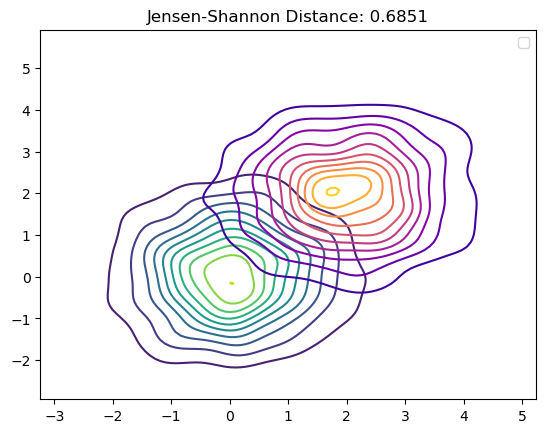

In [117]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neighbors import KernelDensity
from scipy.stats import multivariate_normal
from scipy.spatial.distance import jensenshannon

# Set random seed for reproducibility
np.random.seed(42)

# Generate data for 2D Gaussian N([0, 0], [[1, 0], [0, 1]])
mean1 = np.array([0, 0])
covariance1 = np.array([[1, 0], [0, 1]])
data1 = np.random.multivariate_normal(mean1, covariance1, 1000)

# Generate data for 2D Gaussian N([2, 2], [[1, 0], [0, 1]])
mean2 = np.array([2, 2])
covariance2 = np.array([[1, 0], [0, 1]])
data2 = np.random.multivariate_normal(mean2, covariance2, 1000)

# Fit Kernel Density Estimation (KDE) for both distributions
kde1 = KernelDensity(bandwidth="scott").fit(data1)
kde2 = KernelDensity(bandwidth="scott").fit(data2)

# Generate data points for plotting
x_min, y_min = np.min(np.vstack([data1, data2]), axis=0)
x_max, y_max = np.max(np.vstack([data1, data2]), axis=0)

x, y = np.meshgrid(np.linspace(x_min, x_max, 100), np.linspace(y_min, y_max, 100))
xy = np.column_stack([x.ravel(), y.ravel()])

# Evaluate the KDE on the generated data points
log_density1 = kde1.score_samples(xy)
density1 = np.exp(log_density1).reshape(100, 100)

log_density2 = kde2.score_samples(xy)
density2 = np.exp(log_density2).reshape(100, 100)

# Plot 2D Gaussian N([0, 0], [[1, 0], [0, 1]])
plt.contour(
    x, y, density1, levels=10, cmap="viridis", label="N([0, 0], [[1, 0], [0, 1]]) KDE"
)

# Plot 2D Gaussian N([2, 2], [[1, 0], [0, 1]])
plt.contour(
    x, y, density2, levels=10, cmap="plasma", label="N([2, 2], [[1, 0], [0, 1]]) KDE"
)

# Calculate Jensen-Shannon distance
js_distance = jensenshannon(density1.ravel(), density2.ravel())

plt.title(f"Jensen-Shannon Distance: {js_distance:.4f}")
plt.legend()
plt.show()

Accuracy: 0.92


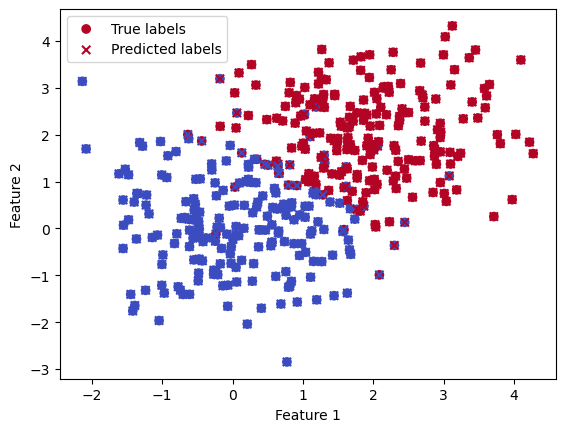

In [118]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score
from sklearn.svm import SVC


# Create labels: 0 for N(0, 1), 1 for N(5, 1)
labels1 = np.zeros(data1.shape[0])
labels2 = np.ones(data2.shape[0])

# Combine data and labels
X = np.vstack([data1, data2])
y = np.concatenate([labels1, labels2])

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Train a Random Forest classifier
# Train an MLP classifier
classifier = MLPClassifier(
    hidden_layer_sizes=(100, 500, 100), max_iter=1000, random_state=42
)
classifier.fit(X_train, y_train)

# Make predictions on the test set
y_pred = classifier.predict(X_test)


# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.2f}")

# Visualize the decision boundary
plt.scatter(
    X_test[:, 0],
    X_test[:, 1],
    c=y_test,
    cmap="coolwarm",
    marker="o",
    label="True labels",
)
plt.scatter(
    X_test[:, 0],
    X_test[:, 1],
    c=y_pred,
    cmap="coolwarm",
    marker="x",
    label="Predicted labels",
)
plt.xlabel("Feature 1")
plt.ylabel("Feature 2")
plt.legend()
plt.show()